In [15]:
%load_ext autoreload
%autoreload 2

import os
import time

import numpy as np
import scanpy as sc
import squidpy as sq
from skimage import io

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [16]:
from napari_sparrow import functions as fc

In [17]:
from dask.distributed import Client

client = Client(
    n_workers=1,
    threads_per_worker=1,
    memory_limit="200GB",
    local_directory="/srv/scratch",
    dashboard_address=42738,
)
client

/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/distributed/node.py:182: UserWarning: Port 42738 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 46375 instead
  warnings.warn(


Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:46375/status,
Dashboard: http://127.0.0.1:46375/status,Workers: 1
Total threads: 1,Total memory: 186.26 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:39477,Workers: 1
Dashboard: http://127.0.0.1:46375/status,Total threads: 1
Started: Just now,Total memory: 186.26 GiB
Comm: tcp://127.0.0.1:44438,Total threads: 1
Dashboard: http://127.0.0.1:43319/status,Memory: 186.26 GiB
Nanny: tcp://127.0.0.1:42968,


In [18]:
# Path prefix for the data folder, use variable from .env file or default
# DATA_PATH_PREFIX = os.getenv("DATA_PATH_PREFIX", default="../data")
DATA_PATH_PREFIX = "/srv/scratch/data/spatial"
SMALL_IMAGE = os.getenv("SMALL_IMAGE", default="False") in ["True", "true", "t"]
DEVICE = os.getenv("DEVICE", default="cuda:4")

name_slide = "A1-1"
path_coordinates = DATA_PATH_PREFIX + "/resolve_liver/20272_slide1_" + name_slide + "_results.txt"
path_image = DATA_PATH_PREFIX + "/resolve_liver/20272_slide1_" + name_slide + "_DAPI.tiff"
t_start = time.time()
img = io.imread(path_image)
imgTest = img
ic = sq.im.ImageContainer(imgTest, layer="raw_image")

INFO:basicpy.basicpy:Initializing BaSiC 140428257783392 with parameters: 
smoothness_flatfield: 1

INFO:basicpy.basicpy:=== BaSiC fit started ===
INFO:basicpy.basicpy:reweighting iteration 0
INFO:basicpy.basicpy:single-step optimization score: 7.006038913459633e-07.
INFO:basicpy.basicpy:mean of S: 1.0.
INFO:basicpy.basicpy:Iteration 0 finished.
INFO:basicpy.basicpy:reweighting iteration 1
INFO:basicpy.basicpy:single-step optimization score: 8.519558036823582e-07.
INFO:basicpy.basicpy:mean of S: 1.0000001192092896.
INFO:basicpy.basicpy:Iteration 1 finished.
INFO:basicpy.basicpy:reweighting score: 0.00963823776692152
INFO:basicpy.basicpy:elapsed time: 7.967313177883625 seconds
INFO:basicpy.basicpy:Reweighting converged.
INFO:basicpy.basicpy:=== BaSiC fit finished in 9.394322730600834 seconds ===
INFO:basicpy.basicpy:=== BaSiC transform started ===
INFO:basicpy.basicpy:=== BaSiC transform finished in 2.2734391801059246 seconds ===
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/pyt

ImageContainer[shape=(12864, 10720), layers=['corrected', 'raw_image']]


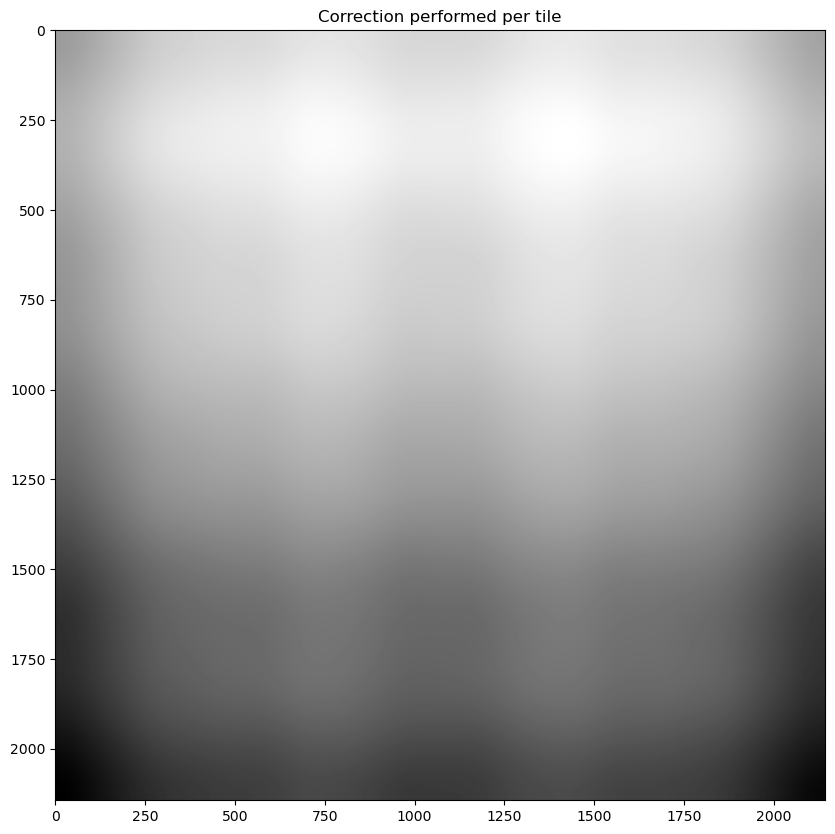

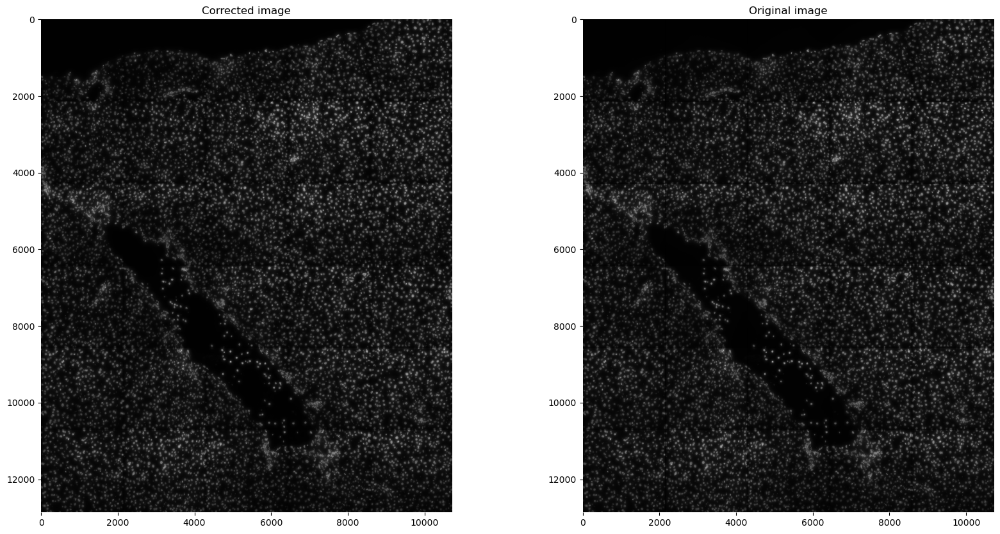

In [19]:
ic, flatfield = fc.tilingCorrection(img=ic)
fc.tilingCorrectionPlot(ic.data.corrected.squeeze().to_numpy(), flatfield, imgTest)

37.63242769241333


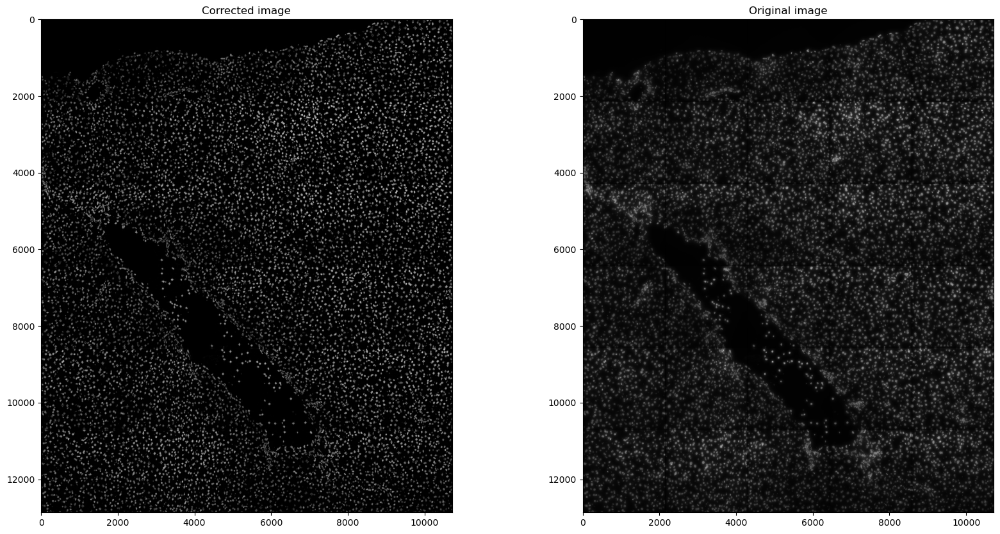

In [20]:
t0 = time.time()
ic = fc.preprocessImage(img=ic, size_tophat=45, contrast_clip=3.5)
print(time.time() - t0)
fc.preprocessImagePlot(ic.data.corrected.squeeze().to_numpy(), ic.data.raw_image.squeeze().to_numpy())

/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/distributed/client.py:3106: UserWarning: Sending large graph of size 263.04 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(
napari.manifest -> 'napari-spongepy' could not be imported: Cannot find module 'napari_spongepy' declared in entrypoint: 'napari_spongepy:napari.yaml'
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/distributed/client.py:3106: UserWarning: Sending large graph of size 128.00 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(


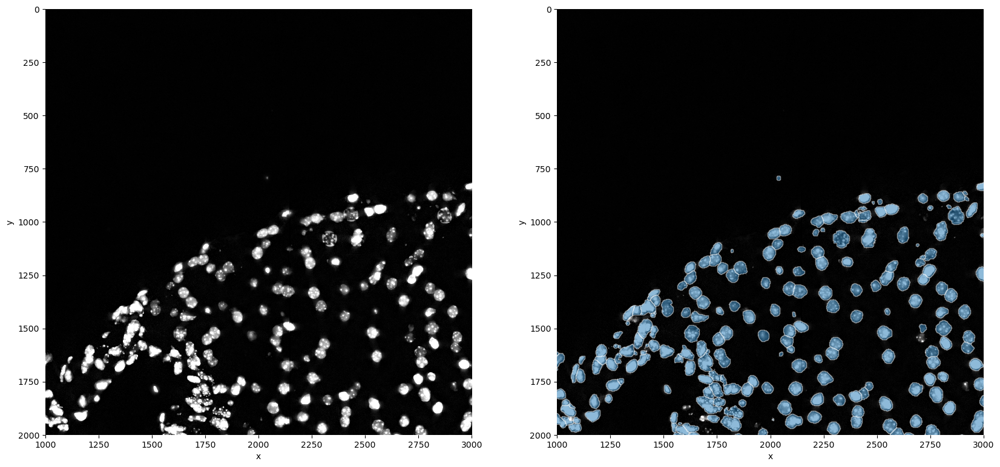

In [21]:
sdata = fc.segmentation(
    img=ic,
    min_size=80,
    cellprob_threshold=-4,
    flow_threshold=0.9,
    diameter=50,
    model_type="nuclei",
    device="cuda:0",
)
fc.segmentationPlot(sdata, crd=[0, 2000, 1000, 3000])

In [22]:
sdata = fc.read_in_RESOLVE(path_coordinates, sdata=sdata)

Started df calculation


/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/distributed/client.py:3106: UserWarning: Sending large graph of size 526.06 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(


df calculated
finished groupby


/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/anndata/_core/anndata.py:117: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/srv/scratch/lottep/tryout_spongepy/napari-spongepy/src/napari_sparrow/functions.py:578: UserWarning: Converting `region_key: region` to categorical dtype.
  sdata.table=spatialdata.models.TableModel.parse(adata,region_key='region',region=1,instance_key='instance')
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/distributed/client.py:3106: UserWarning: Sending large graph of size 263.03 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(


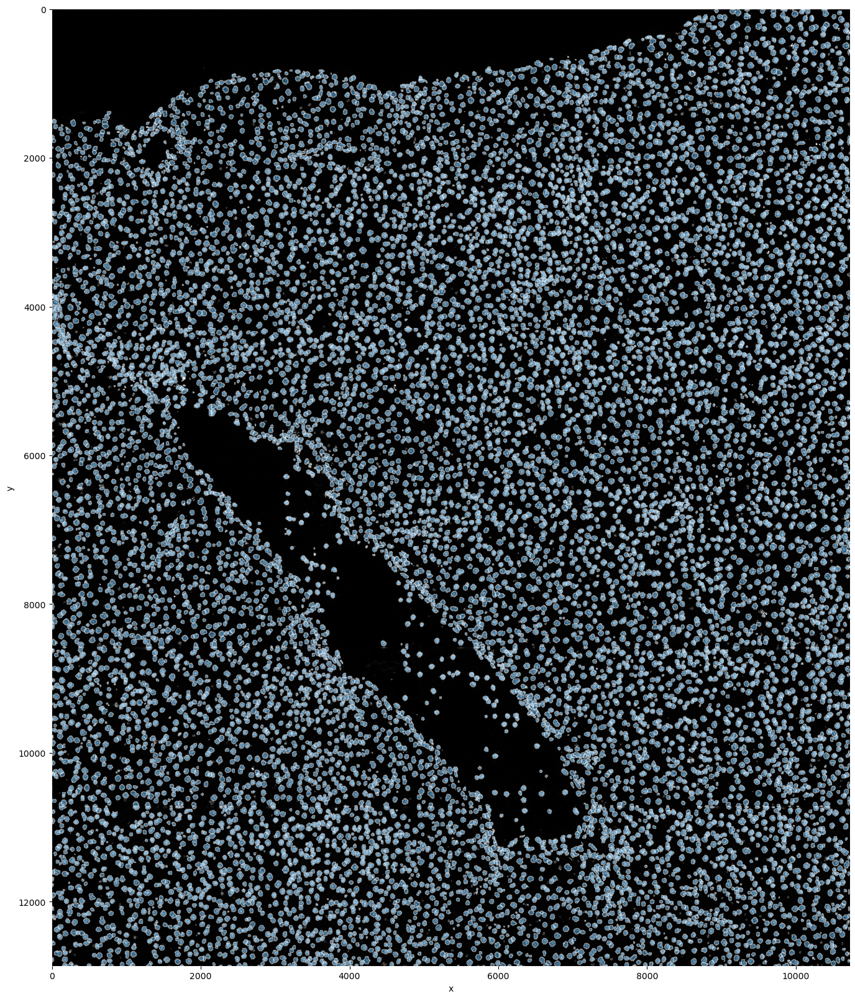

In [23]:
sdata, df = fc.allocation(sdata, verbose=True)
fc.plot_shapes(sdata, shapes_layer="nucleus_boundaries")

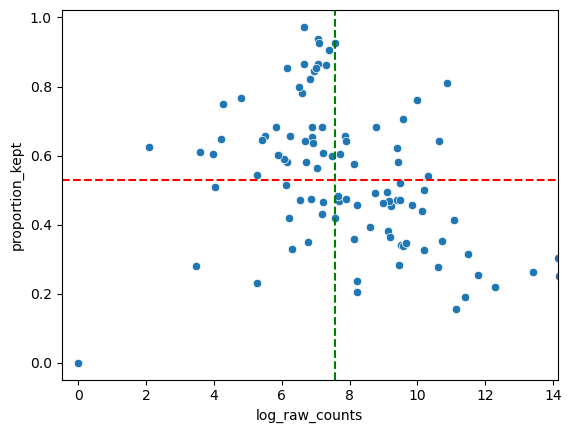

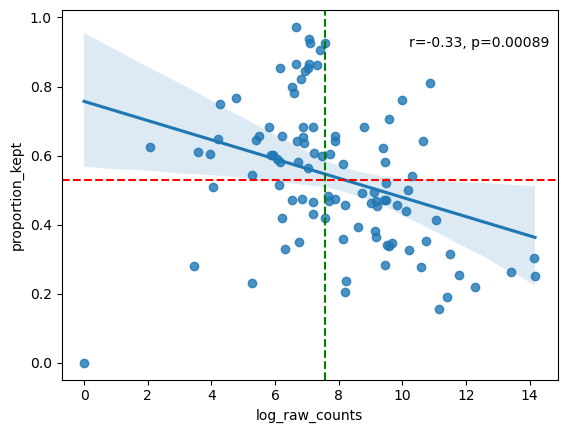

The ten genes with the highest proportion of transcripts filtered out
          proportion_kept  raw_counts
gene                                 
Ms4a7            0.000000           1
Gls2             0.155182       69035
Glul             0.190597       89823
Atp6v0d2         0.204849        3671
Ghr              0.218402      215502
Folr2            0.231959         194
Des              0.236055        3711
Cyp2e1           0.252489     1421904
Hal              0.254086      130806
Fn1              0.264264      677966


In [24]:
filtered = fc.analyse_genes_left_out(sdata, df)

/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/distributed/client.py:3106: UserWarning: Sending large graph of size 263.03 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(


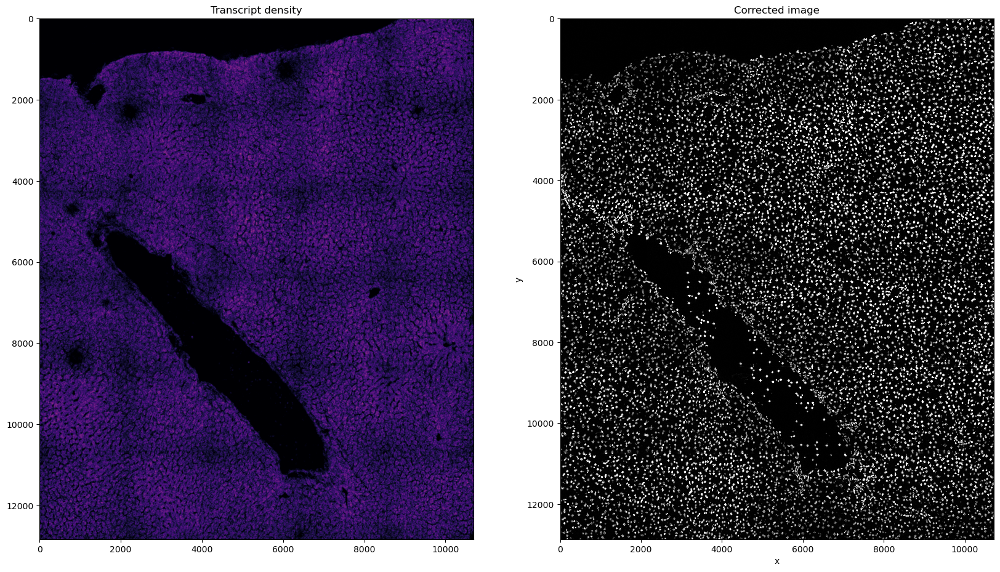

In [25]:
blurred = fc.control_transcripts(df)  # do we ad this image to the sdata object?
fc.plot_control_transcripts(blurred, sdata)

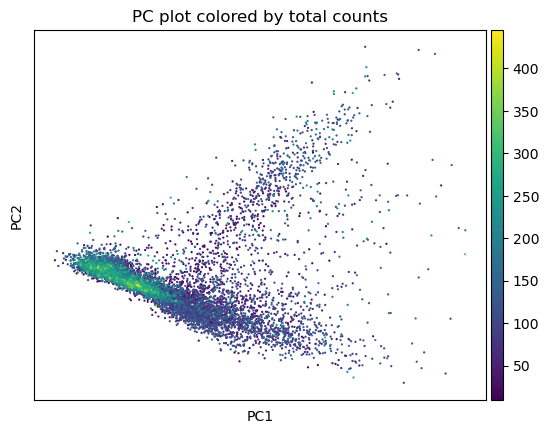

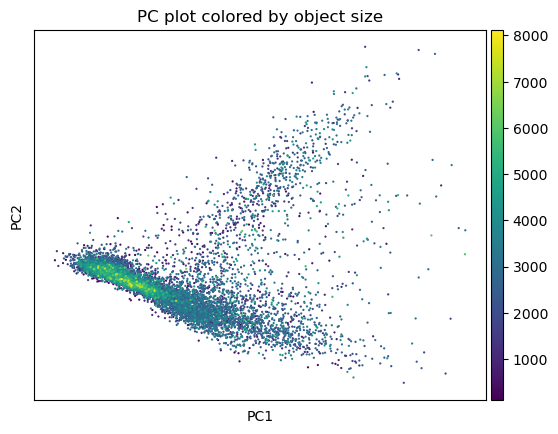

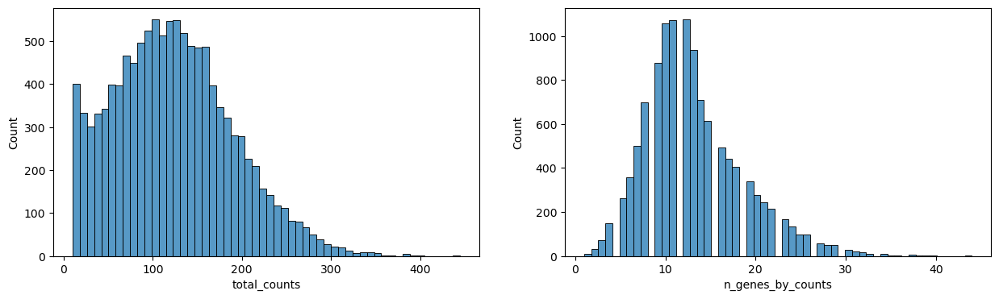

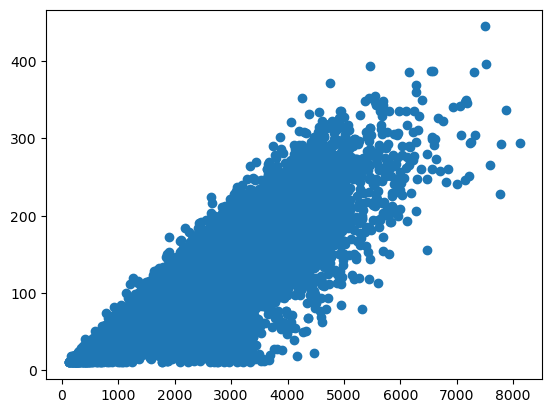

In [26]:
sdata = fc.preprocessAdata(sdata)
fc.preprocesAdataPlot(sdata)

/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/distributed/client.py:3106: UserWarning: Sending large graph of size 263.03 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(


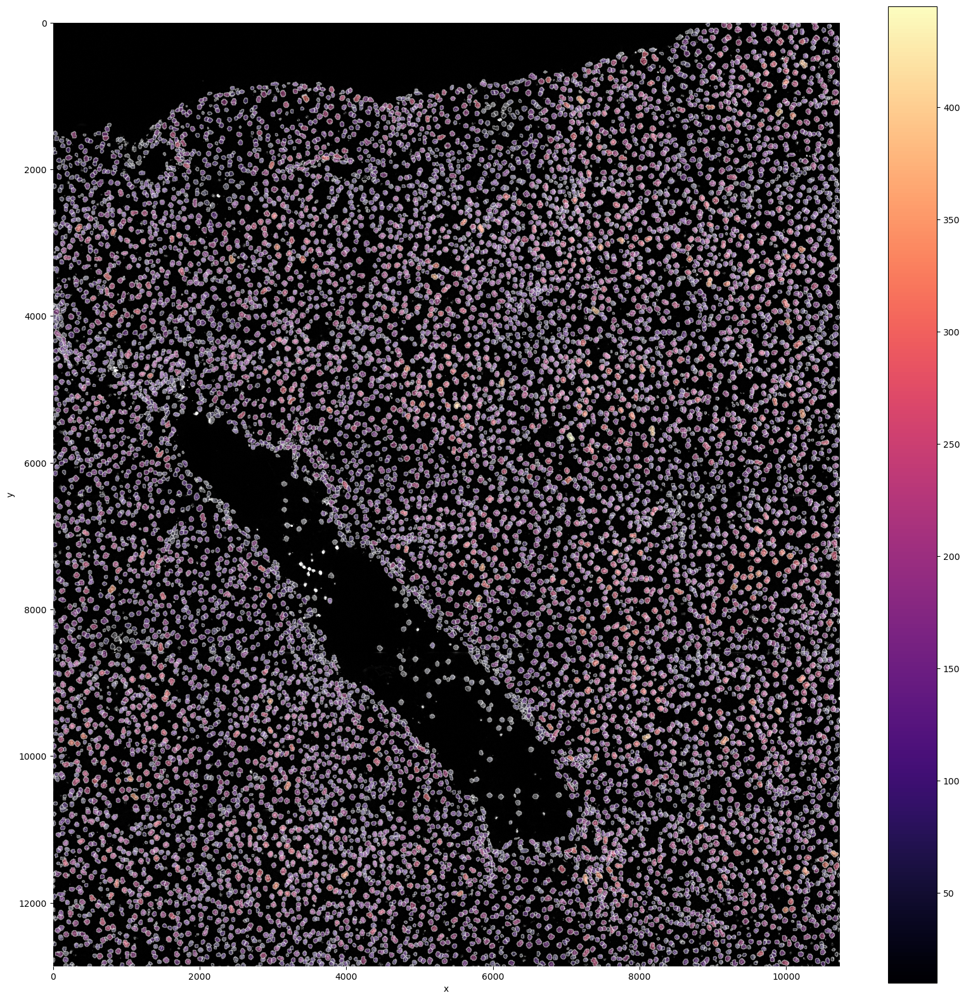

In [28]:
fc.plot_shapes(sdata, column="total_counts")

/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/spatialdata/models/models.py:712: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[cls.ATTRS_KEY] = attr


301 cells were filtered out based on size.


/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/distributed/client.py:3106: UserWarning: Sending large graph of size 263.03 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(


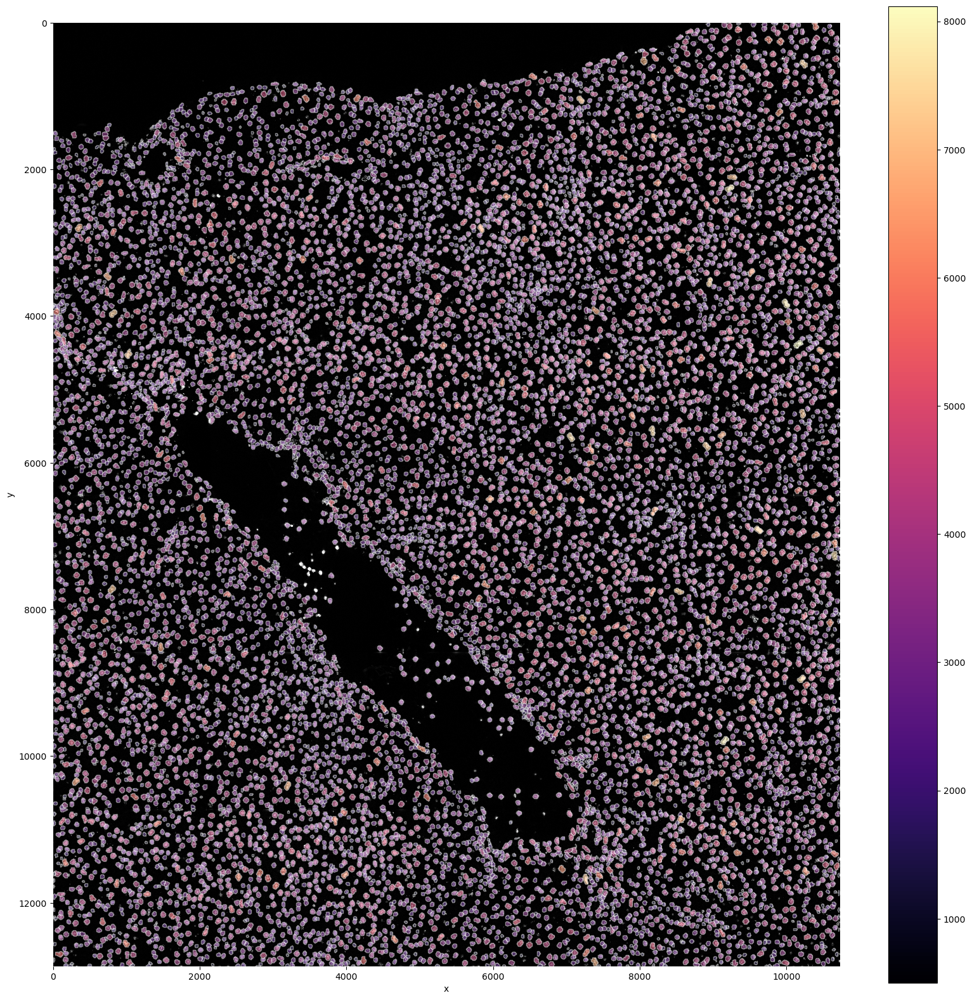

In [29]:
sdata = fc.filter_on_size(sdata, min_size=500)
fc.plot_shapes(sdata, column="shapeSize")

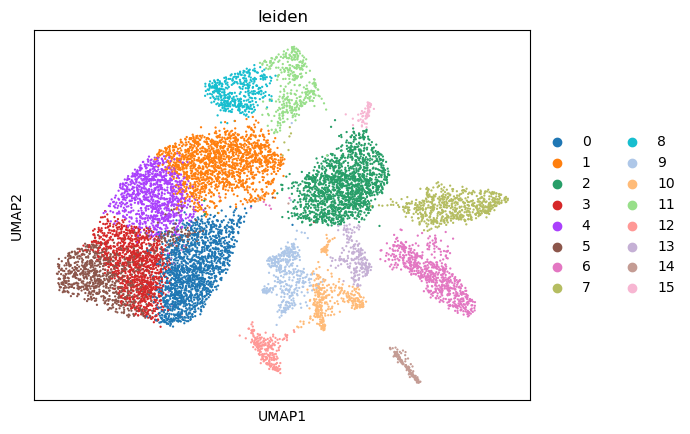

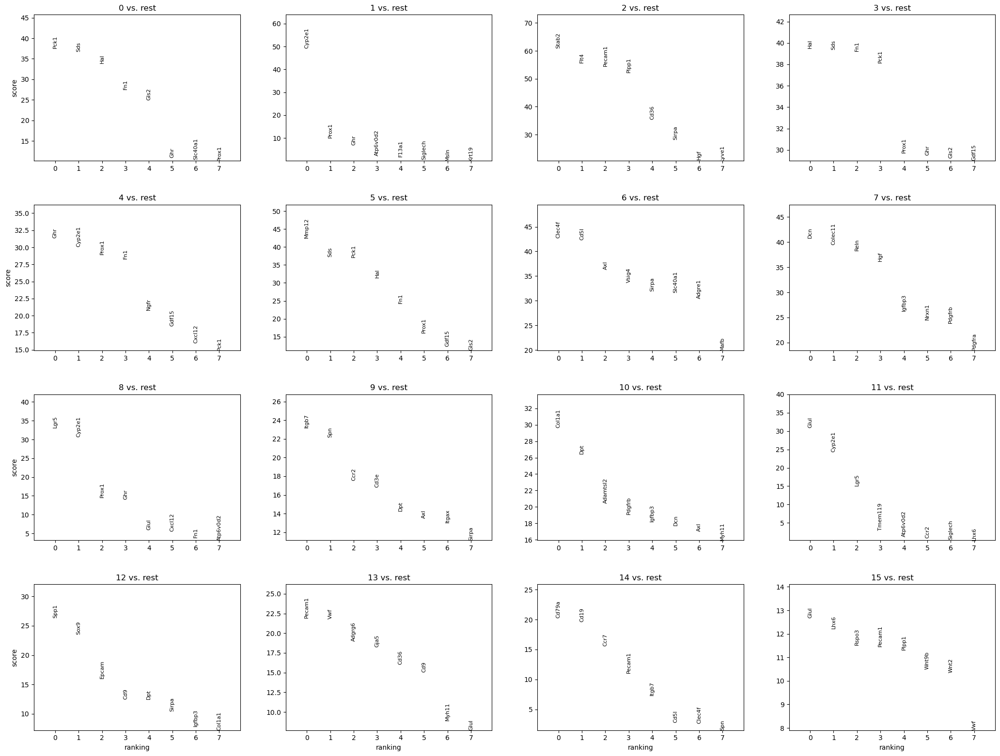

/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/distributed/client.py:3106: UserWarning: Sending large graph of size 263.03 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(


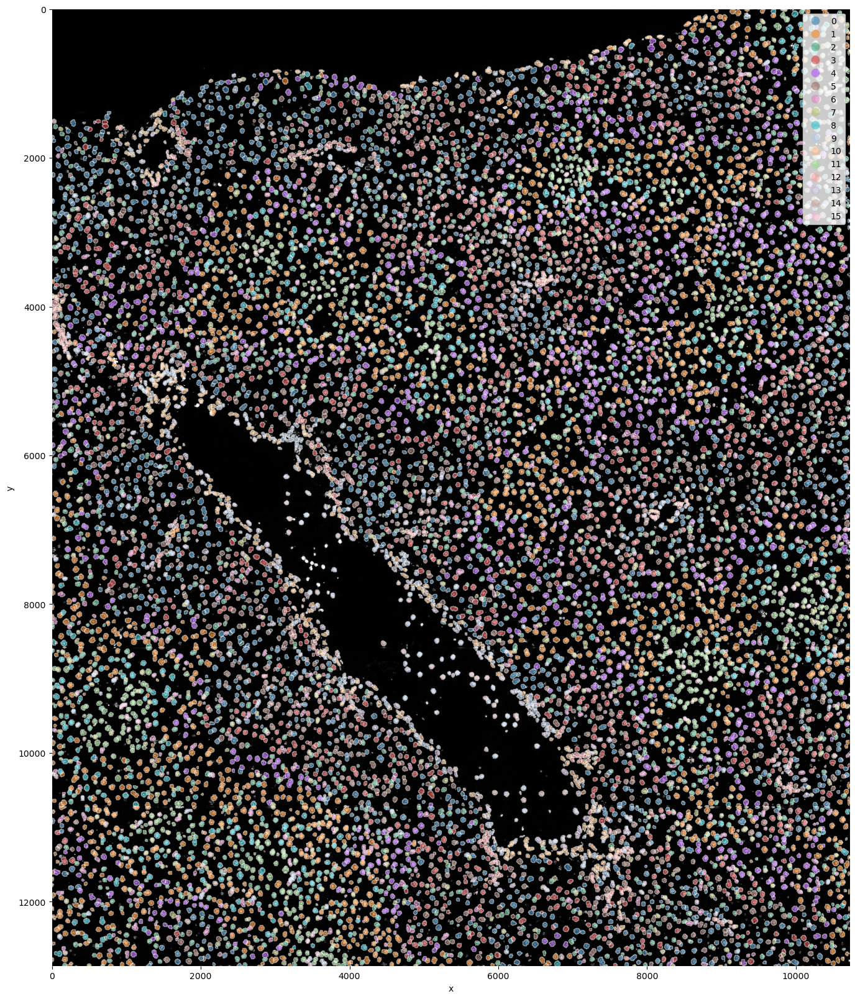

In [30]:
adata = fc.clustering(sdata, 17, 35)
fc.clustering_plot(sdata)
fc.plot_shapes(sdata, column="leiden")

/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and 

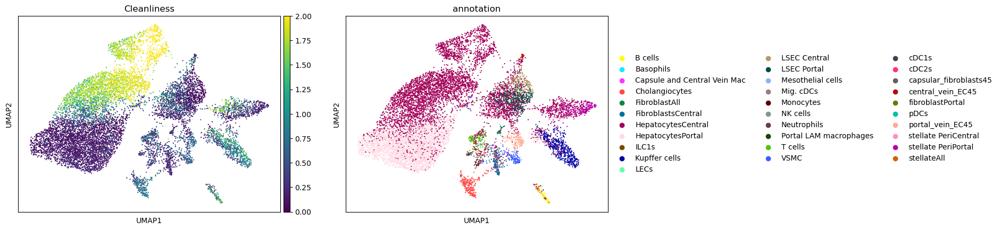

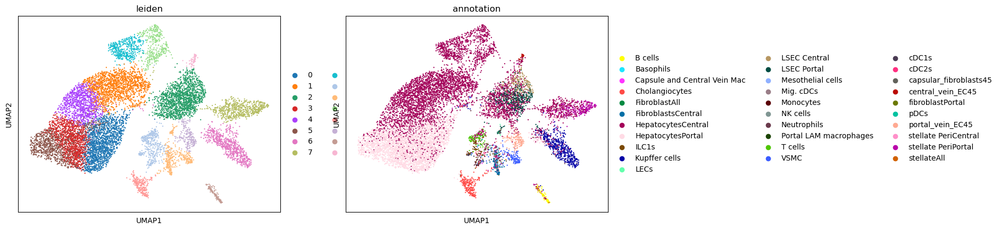

/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/distributed/client.py:3106: UserWarning: Sending large graph of size 263.03 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(


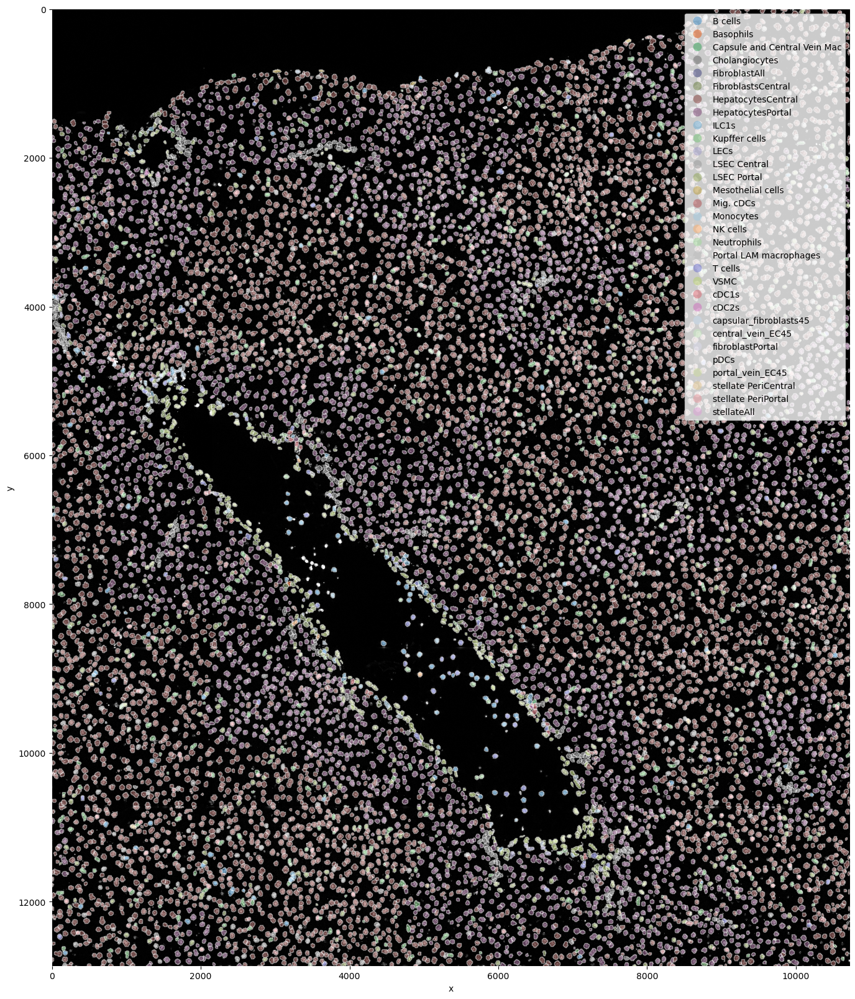

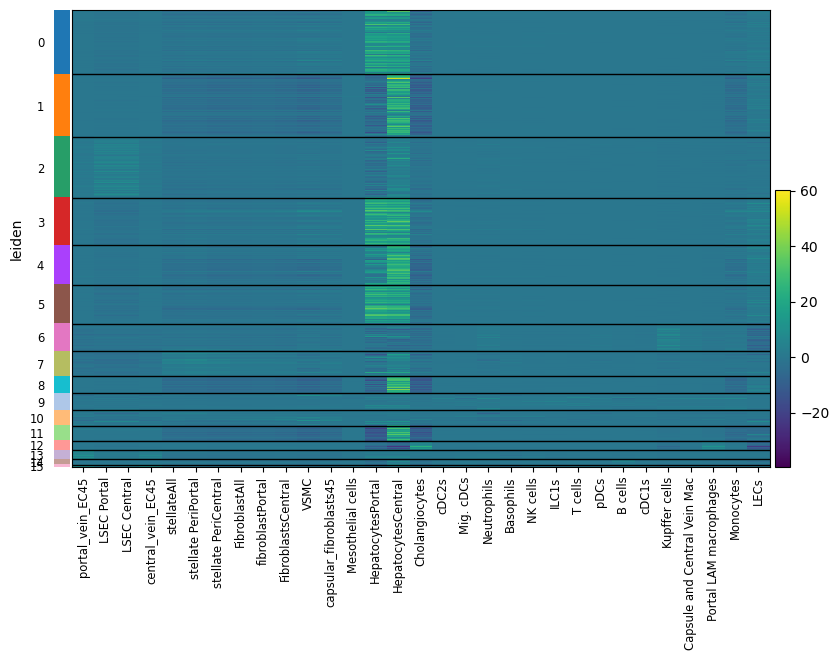

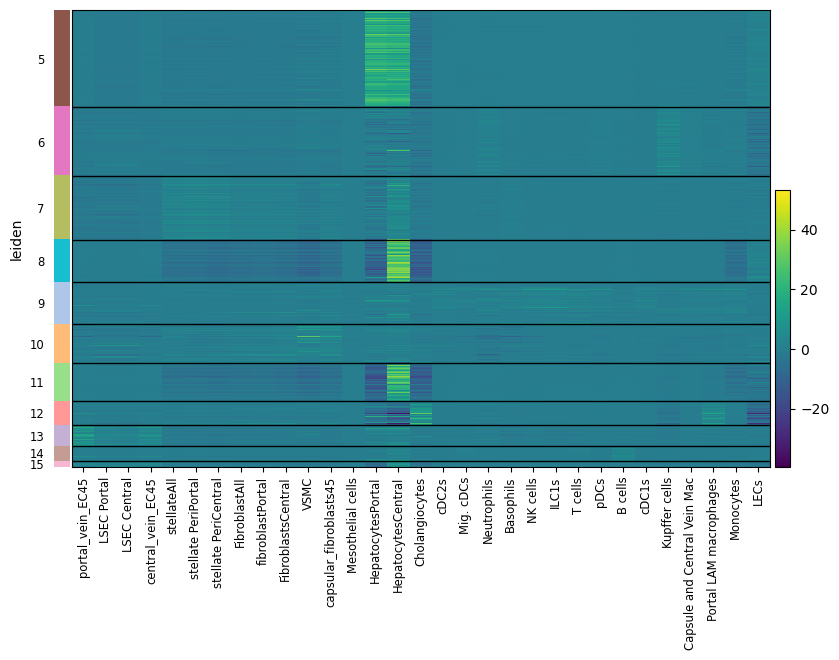

In [31]:
path_mg = DATA_PATH_PREFIX + "/resolve_liver/markerGeneListMartinNoLow.csv"

mg_dict, scoresper_cluster = fc.scoreGenes(
    sdata,
    path_mg,
    repl_columns={"Tot_Score_": "", "uppfer": "upffer"},
    del_celltypes=["Hepatocytes", "LSEC45"],
)
fc.scoreGenesPlot(sdata, scoresper_cluster, 5)

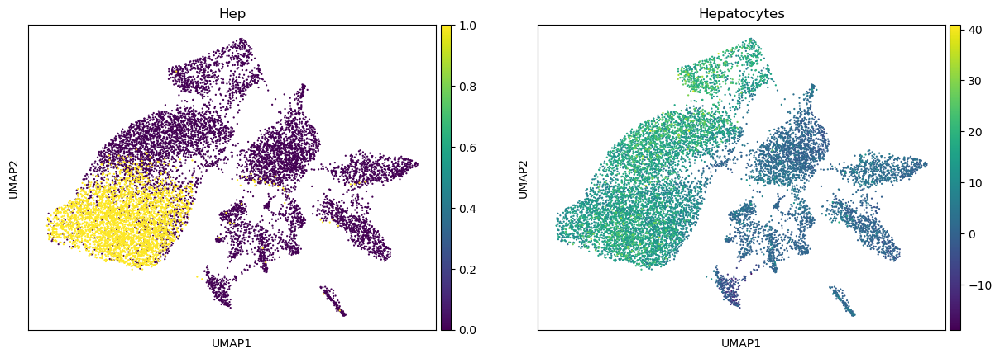

In [32]:
sdata.table.obs["Hep"] = (sdata.table.obs["HepatocytesPortal"] > 10.6).astype(int)
sc.pl.umap(sdata.table, color=["Hep", "Hepatocytes"])

In [33]:
def correct_marker_genes(sdata, Dict):
    """Returns the new AnnData object.

    Corrects marker genes that are higher expessed by dividing them.
    The genes has as keys the genes that should be corrected and as values the threshold and the divider.
    """
    # Correct for all the genes
    for gene, values in Dict.items():
        sdata.table.obs[gene] = np.where(
            sdata.table.obs[gene] < values[0],
            sdata.table.obs[gene] / values[1],
            sdata.table.obs[gene],
        )

    return sdata

In [34]:
sdata = fc.correct_marker_genes(
    sdata, {"HepatocytesPortal": (8.6, 7.0), "HepatocytesCentral": (10.6, 7)}
)  # fix here to hepatocytes portal and central!

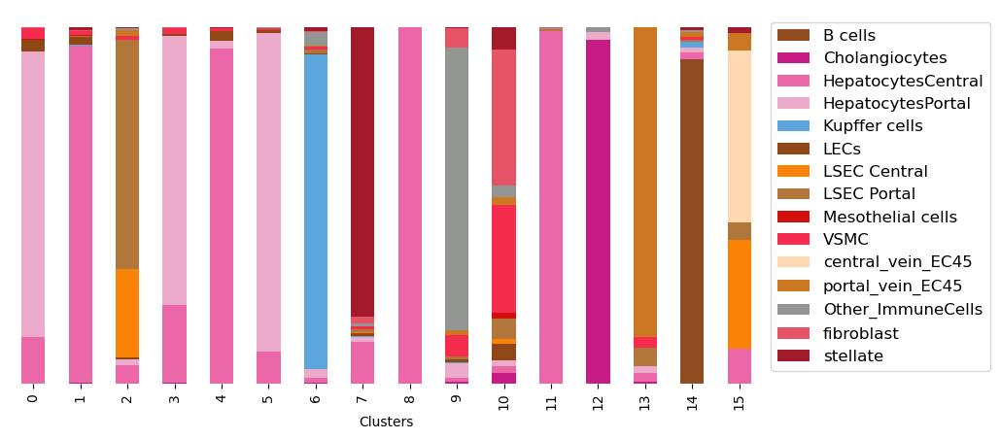

/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/distributed/client.py:3106: UserWarning: Sending large graph of size 263.03 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(


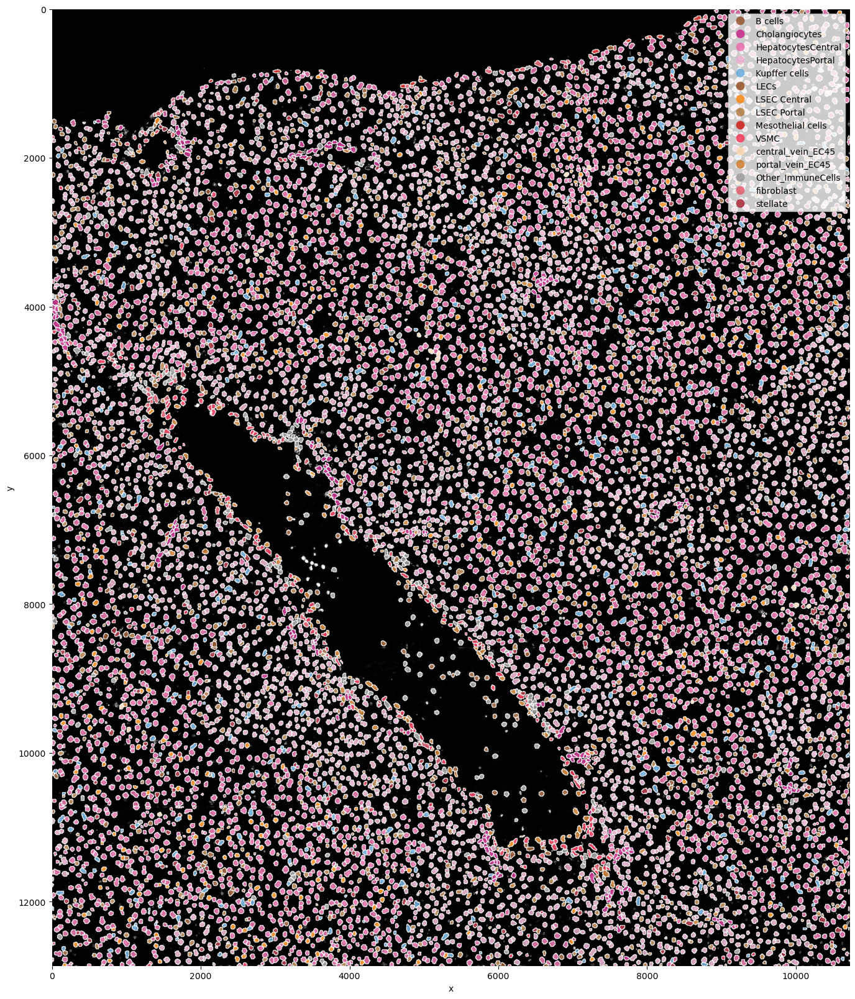

/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/distributed/client.py:3106: UserWarning: Sending large graph of size 128.00 MiB.
This may cause some slowdown.
Consider scattering data ahead of time and using futures.
  warnings.warn(


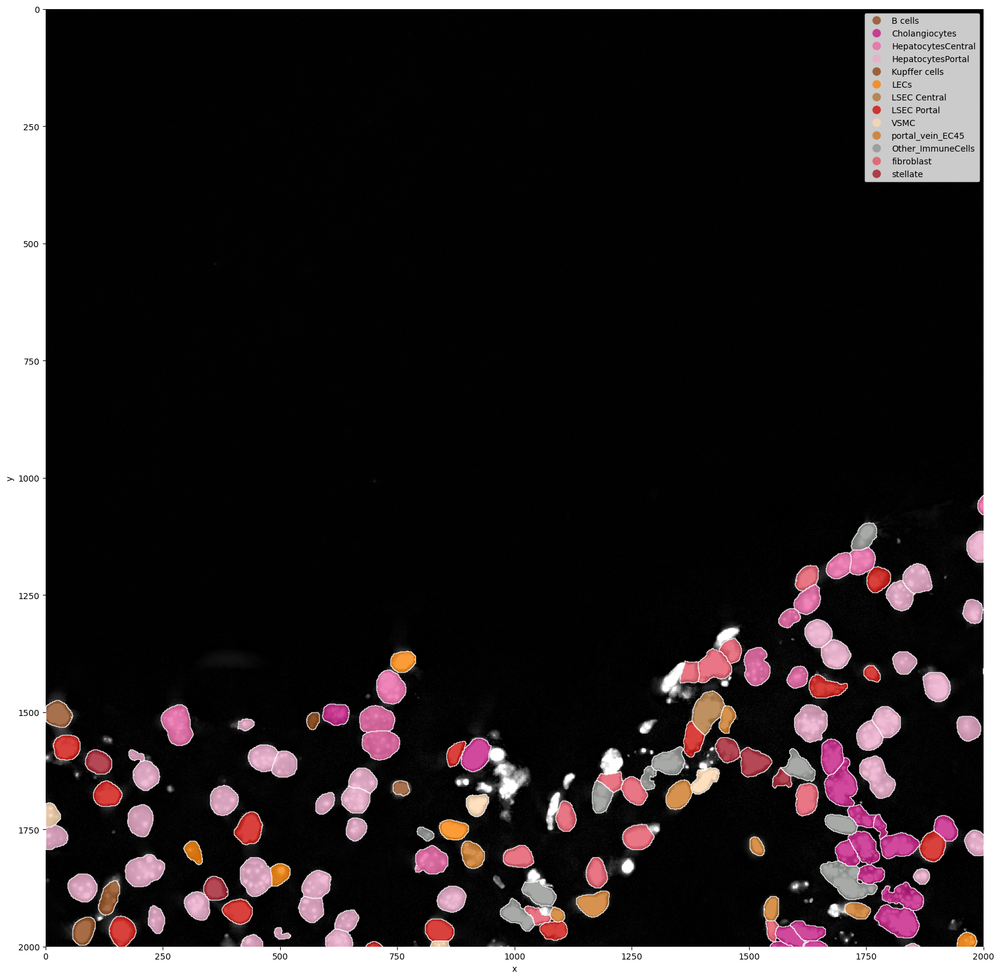

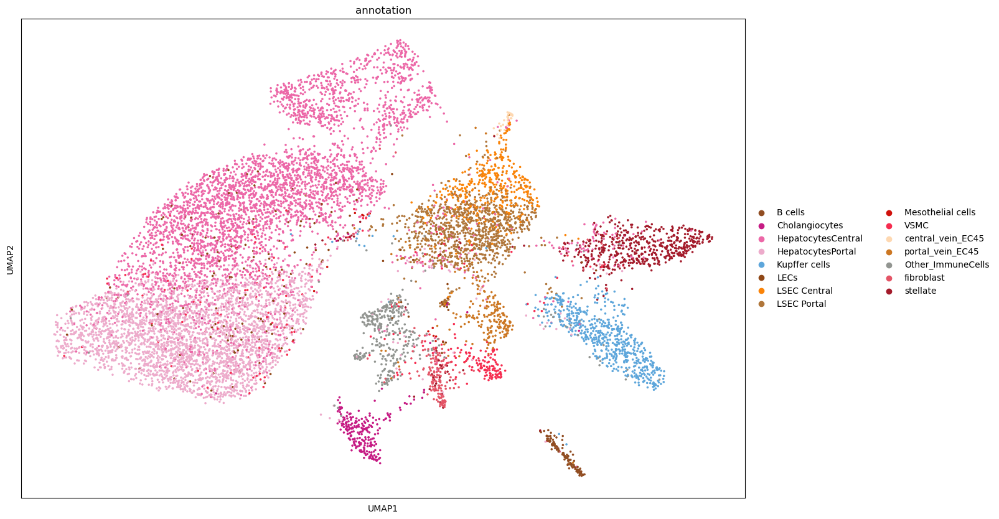

In [35]:
colors = ['#914d22','#c61b84','#ec67a7','#edabcb','#5da6db','#8f4716','#fa8307','#b0763a','#d0110b','#f62c4f','#fed8b1','#cc7722','#929591','#E45466','#a31a2a']
gene_indexes = {"Other_ImmuneCells": [1,2,8,14,15,16,17,18,19,21,22,26], "fibroblast": [4,5,23,25], "stellate": [28,29,30]}

sdata, color_dict = fc.clustercleanliness(sdata, list(mg_dict.keys()), gene_indexes, colors=colors)
fc.clustercleanlinessPlot(sdata, color_dict=color_dict)

In [36]:
print(time.time() - t_start)

6221.2454607486725


In [37]:
sdata.write("/srv/scratch/lottep/sdataA1-1.zarr", overwrite=True)

ValueError: The file path specified is the same as the one used for backing. Overwriting the backing file is not supported to prevent accidental data loss.We are discussing how to support this use case in the future, if you would like us to support it please leave a comment on https://github.com/scverse/spatialdata/pull/138

  0%|          | 0/1000 [00:00<?, ?/s]

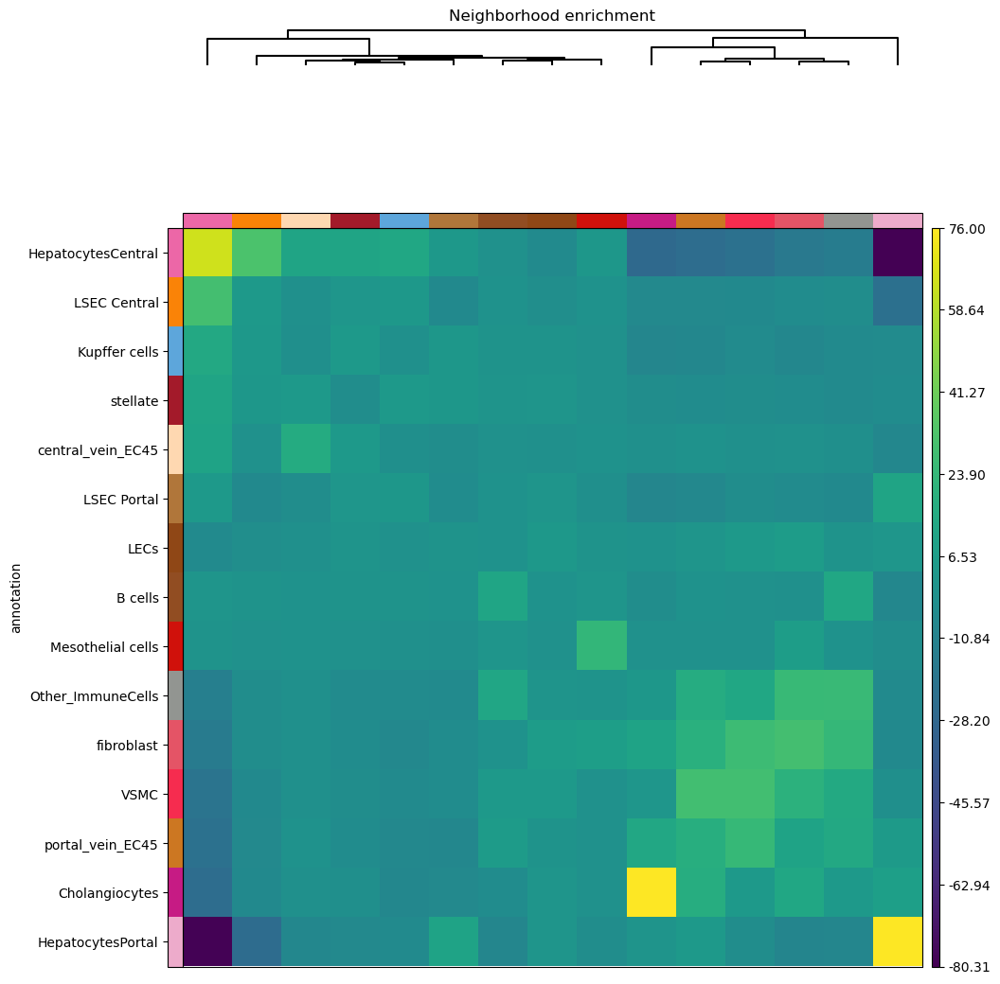

In [39]:
sdata = fc.enrichment(sdata)
fc.enrichment_plot(sdata)

one tile takes 85 seconds 
Two tiles takes 116 seconds. 

With the spatial data, four tiles takes 164 seconds.
Two tiles takes 101 seconds.

The whole slice takes 778 seconds